In [1]:
from sz_utils import data_handler, preprocess
import sz_utils
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

In [2]:
# no limint columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
patients = data_handler.get_patients()
patients[14]

'chb15'

In [44]:
data = data_handler.get_seizure_data(patients[14])
data

,file_name,number_of_seizures,start_end_times
0,chb15_01.edf,0,NaN
1,chb15_02.edf,0,NaN
2,chb15_03.edf,0,NaN
3,chb15_04.edf,0,NaN
4,chb15_05.edf,0,NaN
5,chb15_06.edf,1,"[(272, 397)]"
6,chb15_07.edf,0,NaN
7,chb15_08.edf,0,NaN
8,chb15_09.edf,0,NaN
9,chb15_10.edf,1,"[(1082, 1113)]"


In [42]:
edf = data_handler.get_patient_edf(patients[14])
# edf

In [34]:
%%capture
dataa = data_handler.get_edf_data(patients[14], edf[5])

In [35]:
dataa.head()

,time,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,FZ-CZ,CZ-PZ,PZ-OZ,--2,FP2-F4,F4-C4,C4-P4,P4-O2,--3,FP2-F8,F8-T8,T8-P8-0,P8-O2,--4,P7-T7,T7-FT9,FT9-FT10,FT10-T8,T8-P8-1,--5,FC1-Ref,FC2-Ref,FC5-Ref,FC6-Ref,CP1-Ref,CP2-Ref,CP5-Ref,CP6-Ref
0,0.000000,0.4884,-55.189255,-26.862027,16.117216,-1.0,-37.606838,-15.140415,-7.326007,-5.372405,-1.0,-4.395604,2.442002,-20.02442,-1.0,-17.094017,6.349206,0.4884,-4.395604,-1.0,-27.838828,21.978022,-2.442002,-6.349206,-1.0,27.838828,47.374847,-84.493284,27.838828,-2.442002,-1.0,17.094017,31.746032,6.349206,28.815629,13.186813,27.838828,12.210012,14.163614
1,0.003906,0.4884,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.4884,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
2,0.007812,0.4884,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.4884,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
3,0.011719,0.4884,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.4884,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
4,0.015625,0.4884,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.4884,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400


In [10]:
dataa.shape

(922112, 32)

In [36]:
list_features = ['time','FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
 'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
  'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

len(list_features)

24

In [37]:
# watch the intersection of dataa.columns and list_features

columns_intersection = list(set(dataa.columns).intersection(list_features))
columns_intersection


['C3-P3',
 'P8-O2',
 'P7-T7',
 'time',
 'T7-FT9',
 'FP1-F3',
 'FT10-T8',
 'F4-C4',
 'CZ-PZ',
 'FT9-FT10',
 'P3-O1',
 'T8-P8-1',
 'FP1-F7',
 'FZ-CZ',
 'P4-O2',
 'F8-T8',
 'T7-P7',
 'T8-P8-0',
 'F3-C3',
 'F7-T7',
 'FP2-F8',
 'FP2-F4',
 'C4-P4',
 'P7-O1']

In [38]:
len(columns_intersection)

24

In [45]:
df = dataa[columns_intersection]

In [46]:
df.sample(3)

,C3-P3,P8-O2,P7-T7,time,T7-FT9,FP1-F3,FT10-T8,F4-C4,CZ-PZ,FT9-FT10,P3-O1,T8-P8-1,FP1-F7,FZ-CZ,P4-O2,F8-T8,T7-P7,T8-P8-0,F3-C3,F7-T7,FP2-F8,FP2-F4,C4-P4,P7-O1
194030,-7.326007,-14.163614,18.070818,757.929688,15.140415,-2.442002,-30.769231,12.210012,-0.488400,6.349206,-43.467643,1.465201,3.418803,11.233211,-20.024420,10.256410,-17.094017,1.465201,18.070818,-0.488400,0.488400,0.488400,2.442002,-21.001221
859180,-11.233211,0.488400,26.862027,3356.171875,6.349206,-9.279609,1.465201,-10.256410,-1.465201,-23.931624,-4.395604,-9.279609,4.395604,-1.465201,5.372405,0.488400,-24.908425,-7.326007,-16.117216,-19.047619,-8.302808,-15.140415,3.418803,-4.395604
597124,5.372405,-0.488400,-15.140415,2332.515625,15.140415,1.465201,-6.349206,13.186813,5.372405,1.465201,2.442002,0.488400,0.488400,15.140415,-0.488400,12.210012,15.140415,0.488400,7.326007,10.256410,-1.465201,-5.372405,2.442002,-2.442002


In [41]:
%%capture

prof = ProfileReport(df)
prof.to_file(output_file='chb15.html')

In [ ]:
profile_report.to_widgets()

In [18]:
profile = ProfileReport(df)

profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
prof = ProfileReport(df)
prof.to_file(output_file='chb15.json')

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\scipy\stats\_stats_py.py:5215: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
profile_report = df.profile_report(html={"style": {"full_width": True}})
profile_report.to_file("example.html")

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\scipy\stats\_stats_py.py:5215: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
profile = ProfileReport(df, minimal=True)
profile.to_file("output.html")

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

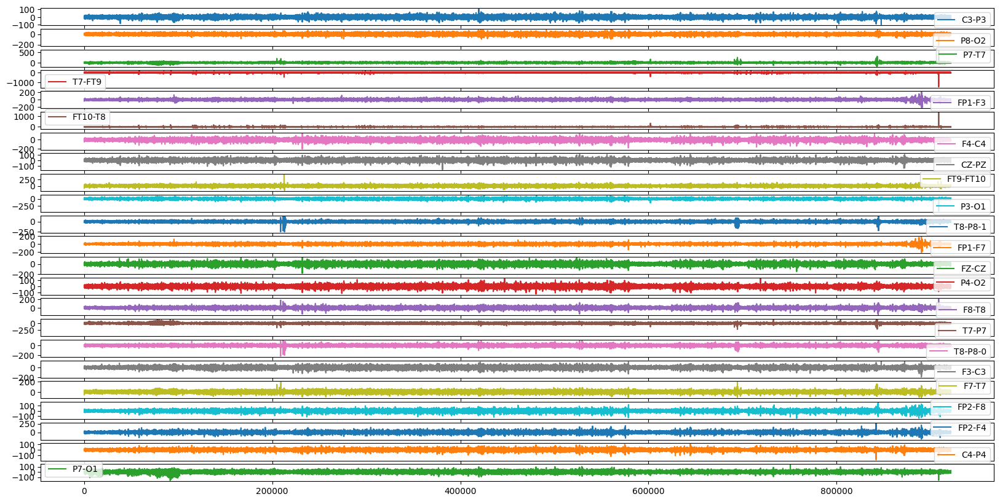

In [47]:
import matplotlib.pyplot as plt
df = df.drop(columns=['time'])
df.plot(subplots=True, figsize=(20, 10))
plt.show()

<AxesSubplot: >

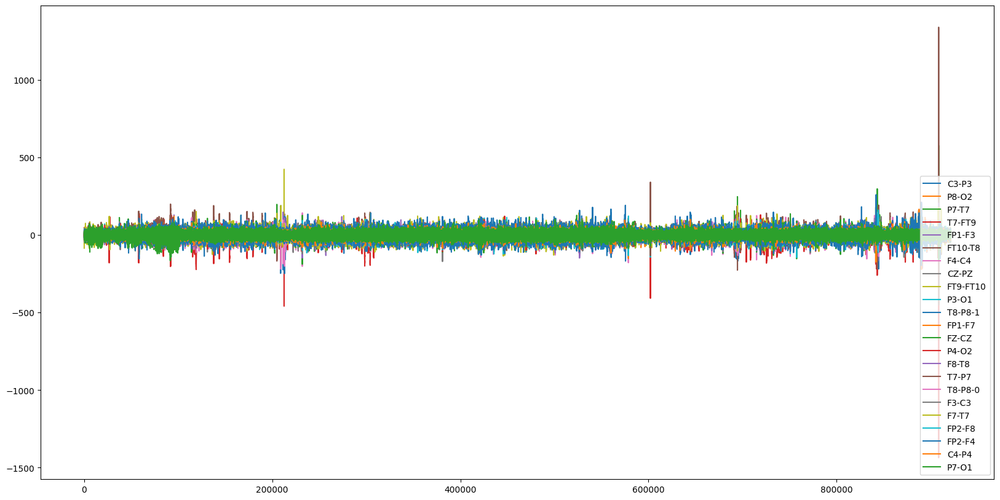

In [48]:
df.plot(figsize=(20, 10))

In [29]:
seizure_data = data_handler.get_seizure_data(patients[14])
seizure_data

,file_name,number_of_seizures,start_end_times
0,chb15_01.edf,0,NaN
1,chb15_02.edf,0,NaN
2,chb15_03.edf,0,NaN
3,chb15_04.edf,0,NaN
4,chb15_05.edf,0,NaN
5,chb15_06.edf,1,"[(272, 397)]"
6,chb15_07.edf,0,NaN
7,chb15_08.edf,0,NaN
8,chb15_09.edf,0,NaN
9,chb15_10.edf,1,"[(1082, 1113)]"


In [50]:
type(seizure_data)

pandas.core.frame.DataFrame

In [57]:
seizure_data

,file_name,number_of_seizures,start_end_times
0,chb15_01.edf,0,NaN
1,chb15_02.edf,0,NaN
2,chb15_03.edf,0,NaN
3,chb15_04.edf,0,NaN
4,chb15_05.edf,0,NaN
5,chb15_06.edf,1,"[(272, 397)]"
6,chb15_07.edf,0,NaN
7,chb15_08.edf,0,NaN
8,chb15_09.edf,0,NaN
9,chb15_10.edf,1,"[(1082, 1113)]"


In [77]:
# put the values of start_end_times row 5 in a variable
start_end_times = seizure_data['start_end_times'][5]
start_end_times

'[(272, 397)]'

In [81]:
import re

# convert the numbers in a list of numbers
start_end_times = re.findall(r'\d+', s)
start_end_times

['272', '397']

In [82]:
df.sample(3)

,C3-P3,P8-O2,P7-T7,T7-FT9,FP1-F3,FT10-T8,F4-C4,CZ-PZ,FT9-FT10,P3-O1,T8-P8-1,FP1-F7,FZ-CZ,P4-O2,F8-T8,T7-P7,T8-P8-0,F3-C3,F7-T7,FP2-F8,FP2-F4,C4-P4,P7-O1,time,seizure
757724,4.395604,-12.210012,-6.349206,3.418803,-0.488400,0.488400,42.490842,9.279609,0.488400,4.395604,-10.256410,31.746032,20.024420,17.094017,27.838828,6.349206,-9.279609,22.954823,21.001221,45.421245,2.442002,-11.233211,-26.862027,757724,0
280209,1.465201,8.302808,0.488400,-9.279609,-5.372405,-4.395604,7.326007,3.418803,-26.862027,20.024420,-2.442002,19.047619,11.233211,6.349206,12.210012,0.488400,-1.465201,21.001221,26.862027,-3.418803,-2.442002,0.488400,-7.326007,280209,0
758448,15.140415,23.931624,-15.140415,-1.465201,-4.395604,-5.372405,20.024420,23.931624,-17.094017,15.140415,3.418803,0.488400,16.117216,-0.488400,-1.465201,14.163614,2.442002,14.163614,7.326007,2.442002,0.488400,8.302808,17.094017,758448,0


In [84]:
# hay que ver si exite tiempo y si no existe crearlo
# create a new column with the time values called 'time'
df['time'] = df.index
df.head()

,C3-P3,P8-O2,P7-T7,T7-FT9,FP1-F3,FT10-T8,F4-C4,CZ-PZ,FT9-FT10,P3-O1,T8-P8-1,FP1-F7,FZ-CZ,P4-O2,F8-T8,T7-P7,T8-P8-0,F3-C3,F7-T7,FP2-F8,FP2-F4,C4-P4,P7-O1,time,seizure
0,-7.326007,-6.349206,27.838828,47.374847,-37.606838,27.838828,6.349206,2.442002,-84.493284,-5.372405,-2.442002,0.4884,-4.395604,-4.395604,21.978022,-26.862027,-2.442002,-15.140415,-55.189255,-27.838828,-17.094017,0.4884,16.117216,0,0
1,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,1,0
2,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,2,0
3,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,3,0
4,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.4884,0.488400,4,0


In [85]:
# create a new column called "seizure" and fill it with 0
df['seizure'] = 0
# df.head()

In [86]:
# if column time is between start_end_times[0] and start_end_times[1] then fill the column "seizure" with 1
df.loc[(df['time'] >= start_end_times[0]) & (df['time'] <= start_end_times[1]), 'seizure'] = 1
# df.iloc[0:10]

TypeError: Invalid comparison between dtype=int64 and str